In [1]:
import numpy as np

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.print_figure_kwargs = {'bbox_inches':None}
import colorspacious
import PIL
from PIL import Image

import urllib
import spiceypy as spice

In [2]:
import os
notebook_dir=os.path.abspath("")

In [3]:
# get SPICE kernels
def download_spice_kernels(urls):
    fnames =[]
    
    kdir = os.path.join(notebook_dir, 'kernels')
    if not os.path.exists(kdir):
        os.mkdir(kdir)
    
    for url in urls:
        fname = os.path.join(kdir, url.split("/")[-1])
        fnames.append(fname)
        
        if not os.path.exists(fname):
            urllib.request.urlretrieve(url, fname)
            
    return fnames

needed_spice_kernels = ["https://naif.jpl.nasa.gov/pub/naif/generic_kernels/lsk/naif0012.tls",
                        "https://naif.jpl.nasa.gov/pub/naif/generic_kernels/pck/Gravity.tpc",
                        "https://naif.jpl.nasa.gov/pub/naif/generic_kernels/pck/pck00011.tpc",
                        "https://naif.jpl.nasa.gov/pub/naif/generic_kernels/pck/gm_de440.tpc",
                        "https://naif.jpl.nasa.gov/pub/naif/generic_kernels/spk/planets/de440.bsp",
                        "https://naif.jpl.nasa.gov/pub/naif/generic_kernels/spk/satellites/mar097.bsp",
                        "https://naif.jpl.nasa.gov/pub/naif/pds/pds4/maven/maven_spice/spice_kernels/fk/maven_v11.tf"]

local_fnames = download_spice_kernels(needed_spice_kernels)

[spice.furnsh(f) for f in local_fnames];

In [4]:
spice.ktotal('ALL')

7

In [5]:
def fig2rgb_array(fig):
    fig.canvas.draw()
    buf = fig.canvas.tostring_rgb()
    ncols, nrows = fig.canvas.get_width_height()
    return np.frombuffer(buf, dtype=np.uint8).reshape(nrows, ncols, 3)

In [6]:
terminator_color=tuple(colorspacious.cspace_convert([55,60,30],'JCh','sRGB1'))
terminator_color
#terminator_color=(1,1,0)

(0.9438188406898, 0.4292874209648402, 0.3571612301661498)

In [7]:
sza_100_color=tuple(colorspacious.cspace_convert([55,60,250],'JCh','sRGB1'))
sza_100_color

(0.36125749769026144, 0.638756998587341, 0.98616613401745)

In [8]:
def mars_image(time, 
               camera_pos=[1,0,0], camera_up=[0,0,1], extent=3, 
               parallel_projection=True,
               show=True, 
               transparent_background=False, background_color=(0,0,0),
               draw_cloud=False, draw_sza_contours=True, draw_terminator=True, draw_sza_100=True, draw_latlon=True):

    from mayavi import mlab
    mlab.options.offscreen = True
    from tvtk.api import tvtk # python wrappers for the C++ vtk ecosystem
    from tvtk.common import configure_input_data
    import spiceypy as spice
  
    # create a figure window (and scene)
    mfig = mlab.figure(size=(2000, 2000),bgcolor=background_color)

    # load and map the texture
    image_file = 'mars_surface.jpg'
    img = tvtk.JPEGReader()
    img.file_name = image_file
    texture = tvtk.Texture(input_connection=img.output_port, interpolate=1)

    # use a TexturedSphereSource, a.k.a. getting our hands dirty
    R = 1
    Nrad = 500
    sphere = tvtk.TexturedSphereSource(radius=R, theta_resolution=Nrad,
                                       phi_resolution=Nrad)
    sphere_mapper = tvtk.PolyDataMapper(input_connection=sphere.output_port)
    mars = tvtk.Actor(mapper=sphere_mapper, texture=texture)
    mars.property.ambient=0.0
    mars.property.specular=0.15

    #now apply the rotation matrix
    #tvtk only thinks about rotations with Euler angles, so we need to use a SPICE routine to get these
    myet=spice.str2et(time)
    rmat=spice.pxform('IAU_MARS','MAVEN_MSO',myet)
    trmat=spice.pxform('MAVEN_MSO','IAU_MARS',myet)#we need to use transpose because m2eul assumes the matrix defines a coordinate system rotation, the inverse of the matrix to rotate vectors
    rangles=np.rad2deg(spice.m2eul(trmat,2,1,3))#2,1,3 because vtk performs rotations in the order z,x,y and SPICE wants these in REVERSE order
    mars.orientation=rangles[[1,0,2]]#orientation must be specified as x,y,z rotations in that order even though they are applied in the order above
    #OK, that was hard, but now we're good!

    mfig.scene.add_actor(mars)

    # determine scene coordinates 
    camera_pos_norm = camera_pos/np.linalg.norm(camera_pos)
    if camera_up=='NP':
        camera_up=np.matmul(rmat,[0,0,1])
    
    camera_up = camera_up-camera_pos_norm*np.dot(camera_pos_norm,camera_up)
    camera_up = camera_up/np.linalg.norm(camera_up)
    camera_right = np.cross(-camera_pos_norm,camera_up)
    
    if draw_cloud:
        # add a cloud at a specified SZA
        cloud_alt = 50.
        cloud_radius = (3395.+cloud_alt)/3395.
        cloud_post_terminator_illumination_angle = np.rad2deg(np.arccos(1/cloud_radius))
        cloud_end_sza = 90 + cloud_post_terminator_illumination_angle
        print(f'{cloud_radius = }')
        print(f'{cloud_end_sza = }')
        cloud = tvtk.SphereSource(center=(0, 0, 0), radius=cloud_radius,
                                  theta_resolution=Nrad, phi_resolution=Nrad,
                                  start_theta=215, end_theta=235.,
                                  start_phi=89, end_phi=cloud_end_sza)
        cloud_mapper = tvtk.PolyDataMapper()
        configure_input_data(cloud_mapper, cloud.output)
        cloud.update()
        cloud_color = tvtk.Property(opacity=0.25, color=(1, 1, 1))
        # The actor is the actually object in the scene.
        cloud_actor = tvtk.Actor(mapper=cloud_mapper, property=cloud_color)
        cloud_actor.orientation=[90,90,0]
        cloud_actor.property.ambient=1.0
        #cloud_actor.property.specular=0.15
        mfig.scene.add_actor(cloud_actor)
        
        # # draw a line in the limb plane with extending to the projected altitude of the cloud
        # limb_line_angle = np.rad2deg(-45)
        # limb_line_extent = cloud_radius
        # limb_line_t = np.linspace(-limb_line_extent, limb_line_extent, 300)
        # limb_line_vec = np.array([0,1,0]) # MSO y, planet-trailing
        # limb_line_vec = np.cos(limb_line_angle)*camera_right + np.sin(limb_line_angle)*camera_up
        # limb_line_x = limb_line_vec[0]*limb_line_t# + 1.0*camera_pos_norm[0]
        # limb_line_y = limb_line_vec[1]*limb_line_t# + 1.0*camera_pos_norm[1]
        # limb_line_z = limb_line_vec[2]*limb_line_t# + 1.0*camera_pos_norm[2]
        # mlab.plot3d(limb_line_x,limb_line_y,limb_line_z,color=(1,0,0),tube_radius=None,line_width=0.5)
    
    r_eps = 1e-3 # tiny amount to add to radii of surface lines to ensure they render correctly
    
    if draw_latlon:
        #make a lat/lon grid
        latloncolor=(0.25,0.25,0.25)
        line_t = np.linspace(0,2*np.pi,300)
        line_r = 1+r_eps
        longrid=np.arange(0,360,10)
        for lon in longrid:
            line_x = line_r*np.cos(np.deg2rad(lon))*np.cos(line_t)
            line_y = line_r*np.sin(np.deg2rad(lon))*np.cos(line_t)
            line_z = line_r*np.sin(line_t)
            line_x,line_y,line_z=np.transpose(np.array([np.matmul(rmat,[x,y,z]) for x,y,z in zip(line_x,line_y,line_z)]))
            mlab.plot3d(line_x,line_y,line_z,color=latloncolor,tube_radius=None,line_width=0.5)

        latgrid=np.arange(-90,90,10)[1:]
        for lat in latgrid:
            line_x = line_r*np.cos(np.deg2rad(lat))*np.cos(line_t)
            line_y = line_r*np.cos(np.deg2rad(lat))*np.sin(line_t)
            line_z = line_r*np.sin(np.deg2rad(lat))*np.ones_like(line_t)
            line_x,line_y,line_z=np.transpose(np.array([np.matmul(rmat,[x,y,z]) for x,y,z in zip(line_x,line_y,line_z)]))
            mlab.plot3d(line_x,line_y,line_z,color=latloncolor,tube_radius=None,line_width=0.5)

    szagrid=[]
    if draw_sza_contours:
        #add an SZA grid
        szagrid=np.arange(0,181,10)
        
    def draw_sza(sza,szacolor=(0,0,0),line_width=1):
        line_t = np.linspace(0,2*np.pi,300)
        line_r = 1+r_eps
        line_x = line_r*np.cos(np.deg2rad(sza))*np.ones_like(line_t)
        line_y = line_r*np.sin(np.deg2rad(sza))*np.sin(line_t)
        line_z = line_r*np.sin(np.deg2rad(sza))*np.cos(line_t)
        mlab.plot3d(line_x,line_y,line_z,color=szacolor,tube_radius=None,line_width=line_width)
    
    
    
    for sza in szagrid:
        draw_sza(sza,szacolor=(0,0,0))
        mlab.points3d([[1+r_eps]],[[0]],[[0]],color=(0,0,0),mode='sphere',scale_factor=0.02)
        
    if draw_terminator:
        draw_sza(90, szacolor=terminator_color, line_width=2)
        
    if draw_sza_100:
        sza_beyond=100
        draw_sza(sza_beyond,szacolor=sza_100_color,line_width=3)

    #set location of camera and orthogonal projection
    #this needs to go last because other mlab commands can affect it
    camera=mlab.gcf().scene.camera
    if parallel_projection:
        camera_pos=5*camera_pos_norm
        camera.parallel_projection = True
        camera.parallel_scale=extent # half box size
    else:
        camera.parallel_projection = False
        camera.view_angle=50

    camera.position = np.array(camera_pos)
    camera.focal_point = (0,0,0)
    camera.view_up = camera_up
    camera.clipping_range = (0.01,5000)

    #the only way to set a light in mayavi/tvtk is with respect to the camera position
    #default lights are uniform and don't fall off with distance, which is what we want
    mfig.scene.light_manager.light_mode = "vtk"
    sun = mfig.scene.light_manager.lights[0]
    sun.activate = True
    sun_vec=(1,0,0)

    #get the elevation/azimuth coordinates
    #elevation is [-90/+90] +90 is from the direction of camera_up
    #azimuth is [-180/+180] +90 is to the right of the image; +/-180 is behind, pointing at the camera -90 is to the left

    #we need to put the sun in scene coordinates
    sun_scene = np.matmul([camera_right, camera_up, camera_pos_norm],sun_vec)
    
    #elevation is the angle is latitude measured wrt the y-axis of the scene
    sun_elevation = np.rad2deg(np.arcsin(np.dot(sun_scene,[0,1,0])))
    #azimuth is the angle in the x-z plane from the x-axis
    sun_azimuth = np.rad2deg(np.arctan2(sun_scene[0],sun_scene[2]))
    
    sun.azimuth = sun_azimuth
    sun.elevation = sun_elevation
    
    sun.intensity = 1.0-mars.property.ambient

    mlab.show()
    mode = 'rgba' if transparent_background else 'rgb'
    img=mlab.screenshot(mode=mode,antialiased=True)
    mlab.close()

    fig,ax=plt.subplots(1,1,dpi=800,figsize=(2.5,2.5))
    ax.set_xlim([-extent,extent])
    ax.set_ylim([-extent,extent])
    ax.imshow(img,extent=(-extent,extent,-extent,extent))
    
    #suppress all whitespace
    plt.subplots_adjust(top = 1, bottom = 0, right = 1, left = 0, hspace = 0, wspace = 0)
    plt.margins(0,0)
    ax.set_axis_off()
    ax.xaxis.set_major_locator(plt.NullLocator())
    ax.yaxis.set_major_locator(plt.NullLocator()) 
    
    # annotate terminator and SZA=100
    ax.text(0.015,0.99,time,transform=ax.transAxes,fontsize=6,color='w',va='top',ha='left')

    if draw_sza_contours:
        subsolar_2d=[np.dot(camera_right,[1,0,0]),np.dot(camera_up,[1,0,0])]
        ax.text(subsolar_2d[0],subsolar_2d[1]+0.05,'SZA',fontsize=4,color='k',va='center',ha='center')
        ax.text(subsolar_2d[0],subsolar_2d[1]-0.05,'10° intervals',fontsize=3,color='k',va='center',ha='center')

    if draw_terminator:
        ax.text(0.4,0.06,'terminator',transform=ax.transAxes,fontsize=4,color=terminator_color,va='center',ha='right')
        
    if draw_sza_100:
        ax.text(0.15,0.225,'SZA = '+str(sza_beyond)+'°',transform=ax.transAxes,fontsize=4,color=sza_100_color,va='center',ha='right')

    if draw_cloud:
        ax.text(0.25,0.105,f"synthetic cloud\nalt. {int(cloud_alt)} km",transform=ax.transAxes,fontsize=4,color='w',alpha=0.25,va='center',ha='right',ma='center')
        
    fig.canvas.draw()
    
    rgb_array=fig2rgb_array(fig)
    
    return rgb_array

In [9]:
def earth_mars_view(utc,show=False,draw_cloud=False, draw_sza_contours=True, draw_terminator=True, draw_sza_100=True, draw_latlon=True, background_color=(0.0,0.0,0.0)):
    et=spice.utc2et(utc)
    state=spice.spkezr('Mars',et,'MAVEN_MSO','CN+S','Earth')[0]
    
    earth_mars_vec=-state[:3]
    earth_mars_vec=10*earth_mars_vec/np.linalg.norm(earth_mars_vec)

    rgb_arr = mars_image(utc,camera_pos=earth_mars_vec,camera_up='NP',extent=1.15,background_color=background_color,show=show,
                         draw_cloud=draw_cloud, draw_sza_contours=draw_sza_contours, draw_terminator=draw_terminator, draw_sza_100=draw_sza_100, draw_latlon=draw_latlon)
    
    return rgb_arr

In [10]:
2-2

0

/tmp/ipykernel_696901/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


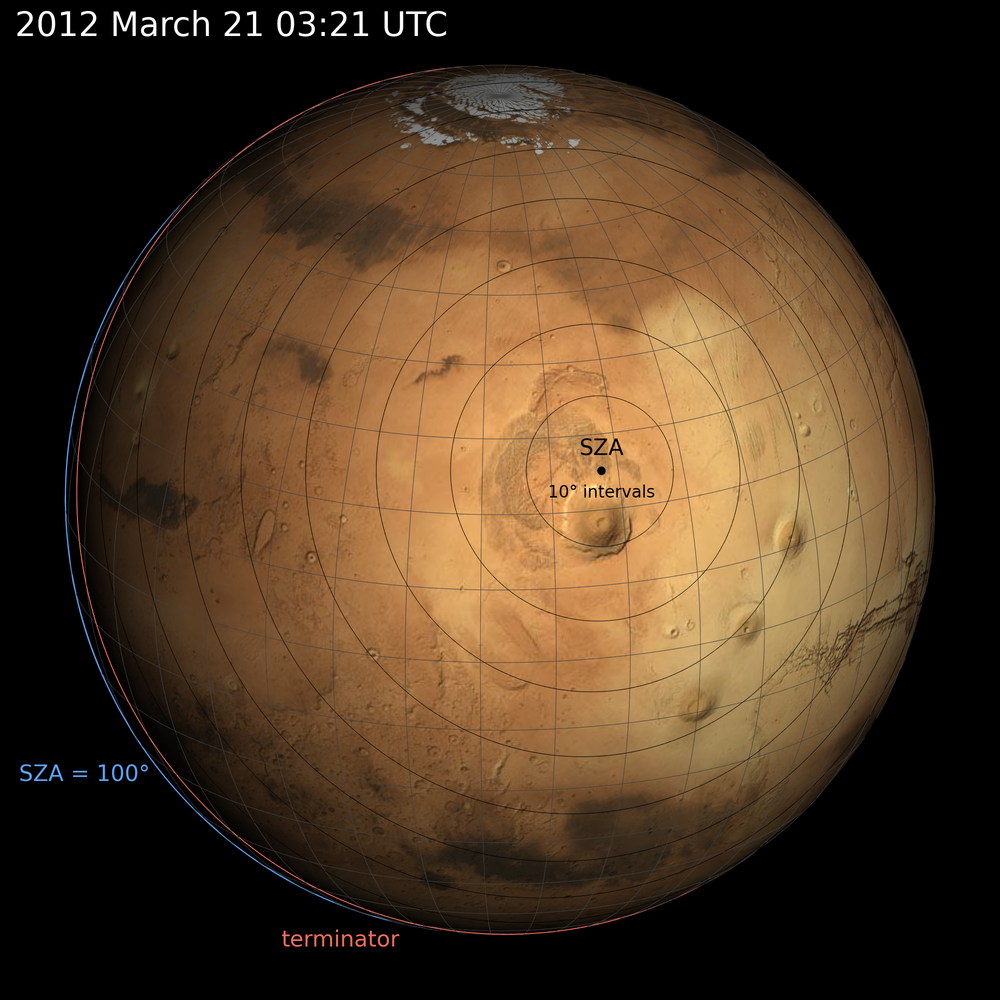

In [11]:
utc='2012 March 21 03:21 UTC'
rgb_arr = earth_mars_view(utc);
mars_img = Image.fromarray(rgb_arr)

In [12]:
%load_ext watermark
%watermark -n -u -v -iv -w -p numpy,matplotlib,colorspacious,PIL,urllib,spiceypy,mayavi,tvtk

Last updated: Tue Sep 24 2024

Python implementation: CPython
Python version       : 3.12.3
IPython version      : 8.27.0

numpy        : 1.26.4
matplotlib   : 3.9.2
colorspacious: 1.1.2
PIL          : 10.4.0
urllib       : unknown
spiceypy     : 6.0.0
mayavi       : 4.8.2
tvtk         : <module 'tvtk.version' from '/home/mike/Documents/Utilities/mike_python_venv/lib/python3.12/site-packages/tvtk/version.py'>

PIL          : 10.4.0
numpy        : 1.26.4
colorspacious: 1.1.2
spiceypy     : 6.0.0
matplotlib   : 3.9.2

Watermark: 2.4.3



cloud_radius = 1.0147275405007363
cloud_end_sza = 99.77360299799814


/tmp/ipykernel_95885/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


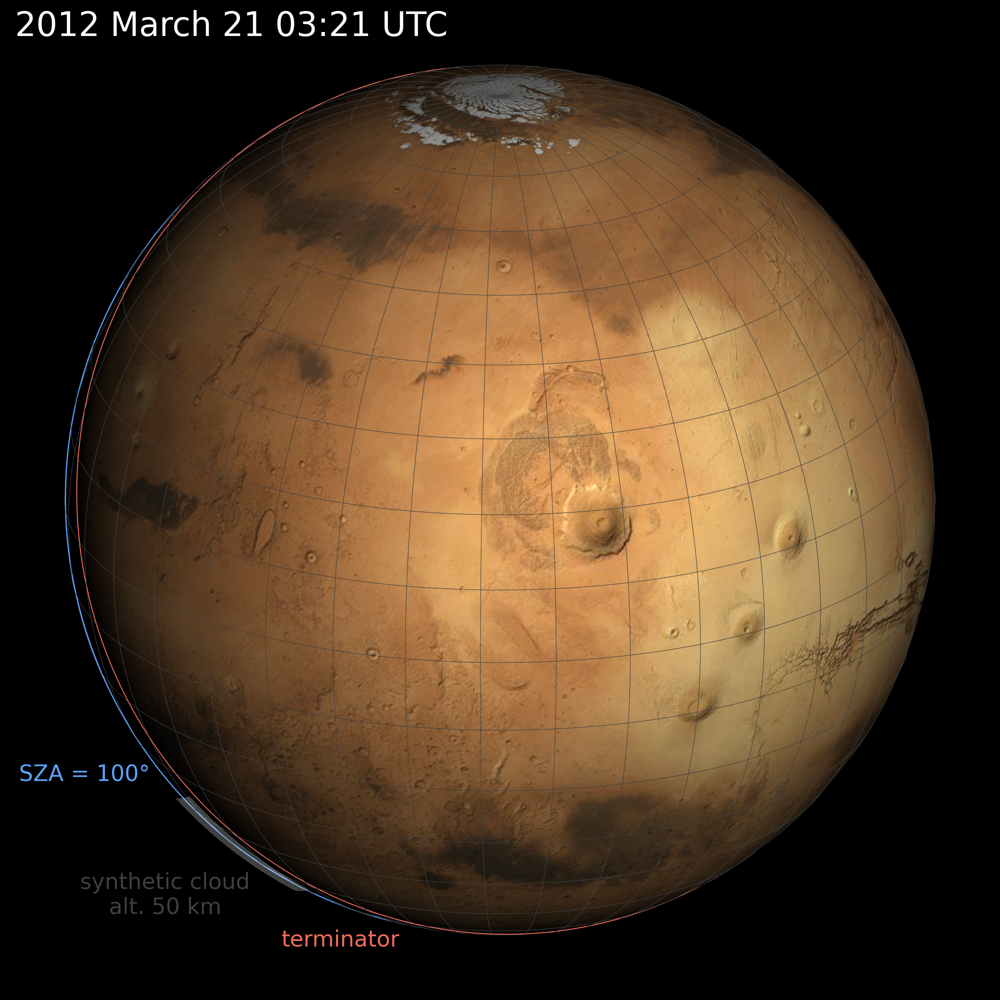

In [13]:
utc='2012 March 21 03:21 UTC'
rgb_arr = earth_mars_view(utc, draw_cloud=True, draw_sza_contours=False, draw_terminator=True, draw_sza_100=True, draw_latlon=True);
mars_img = Image.fromarray(rgb_arr)

cloud_radius = 1.0147275405007363
cloud_end_sza = 99.77360299799814


/tmp/ipykernel_95885/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


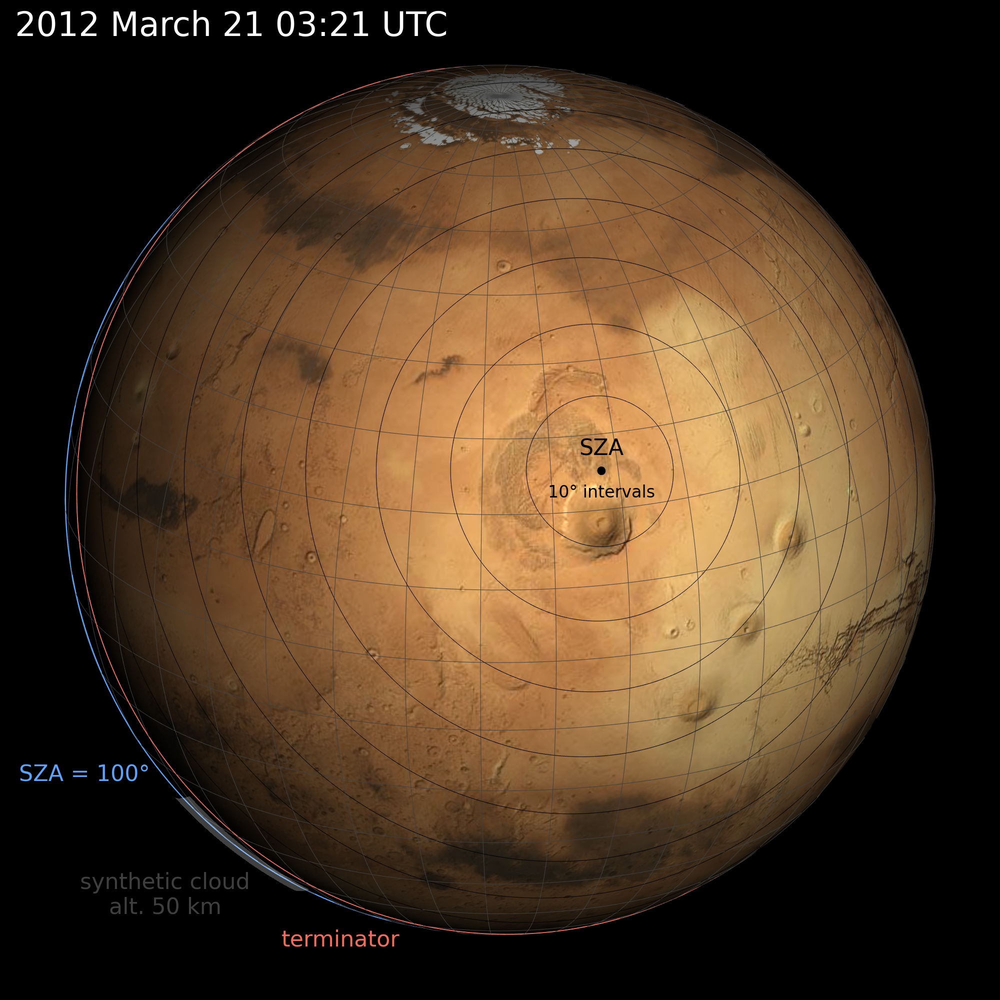

In [14]:
utc='2012 March 21 03:21 UTC'
rgb_arr = earth_mars_view(utc, draw_cloud=True, draw_sza_contours=True, draw_terminator=True, draw_sza_100=True, draw_latlon=True);
mars_img = Image.fromarray(rgb_arr)

cloud_radius = 1.0147275405007363
cloud_end_sza = 99.77360299799814


/tmp/ipykernel_95885/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


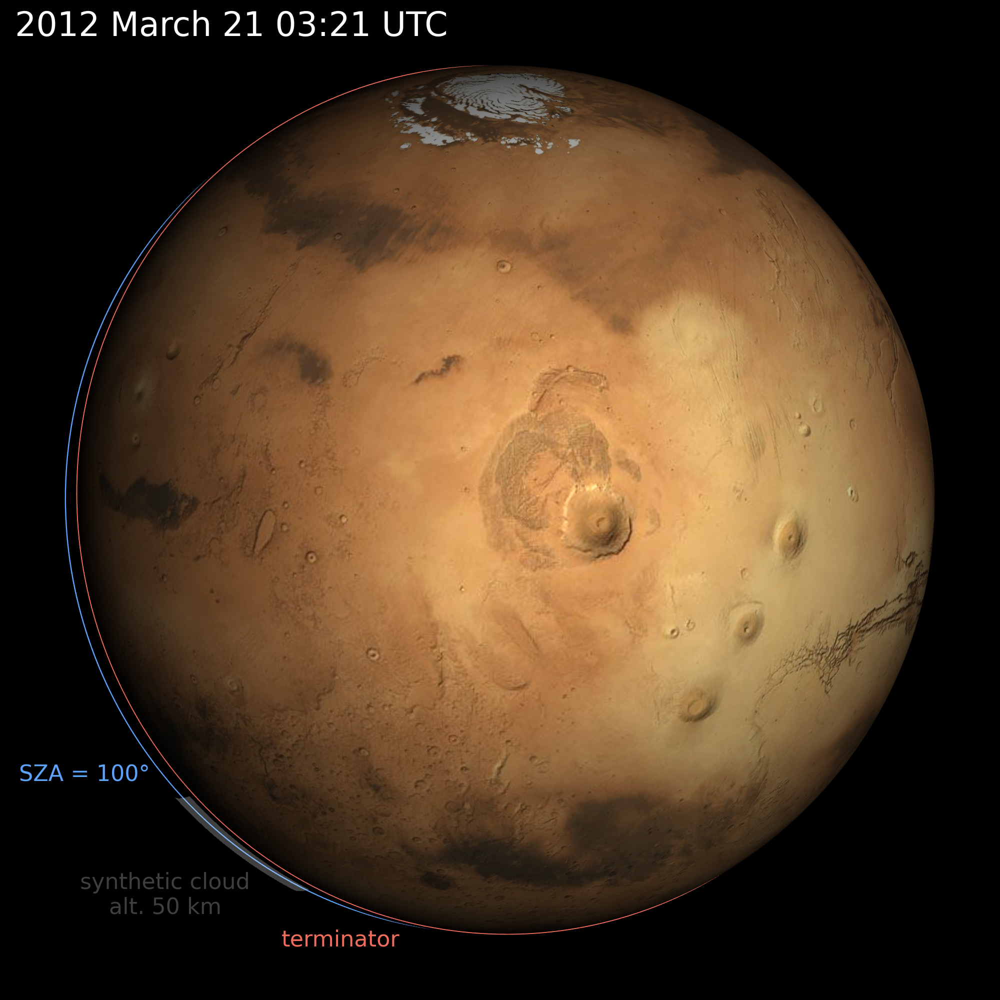

In [15]:
utc='2012 March 21 03:21 UTC'
rgb_arr = earth_mars_view(utc, draw_cloud=True, draw_sza_contours=False, draw_terminator=True, draw_sza_100=True, draw_latlon=False);
mars_img = Image.fromarray(rgb_arr)

cloud_radius = 1.0147275405007363
cloud_end_sza = 99.77360299799814


/tmp/ipykernel_95885/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


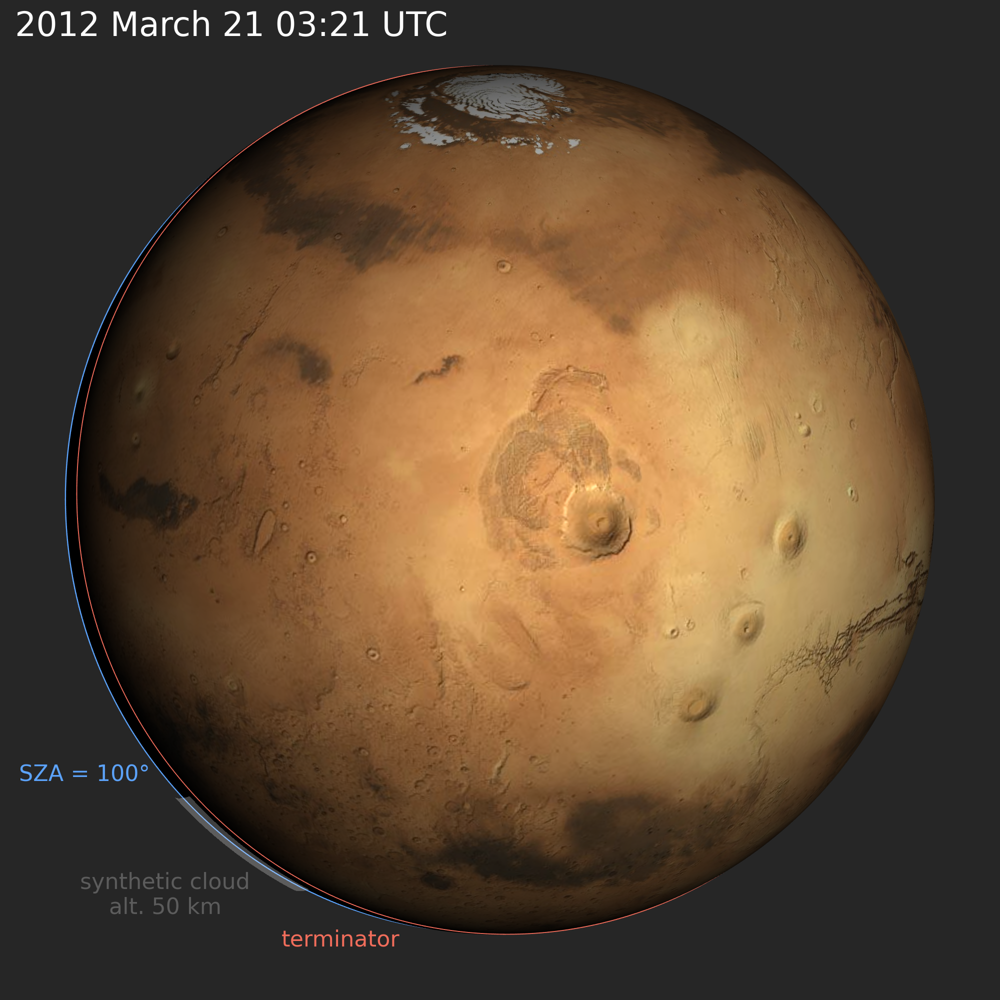

In [16]:
utc='2012 March 21 03:21 UTC'
rgb_arr = earth_mars_view(utc, draw_cloud=True, draw_sza_contours=False, draw_terminator=True, draw_sza_100=True, draw_latlon=False, background_color=(0.15,0.15,0.15));
mars_img = Image.fromarray(rgb_arr)

cloud_radius = 1.0147275405007363
cloud_end_sza = 99.77360299799814


/tmp/ipykernel_95885/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


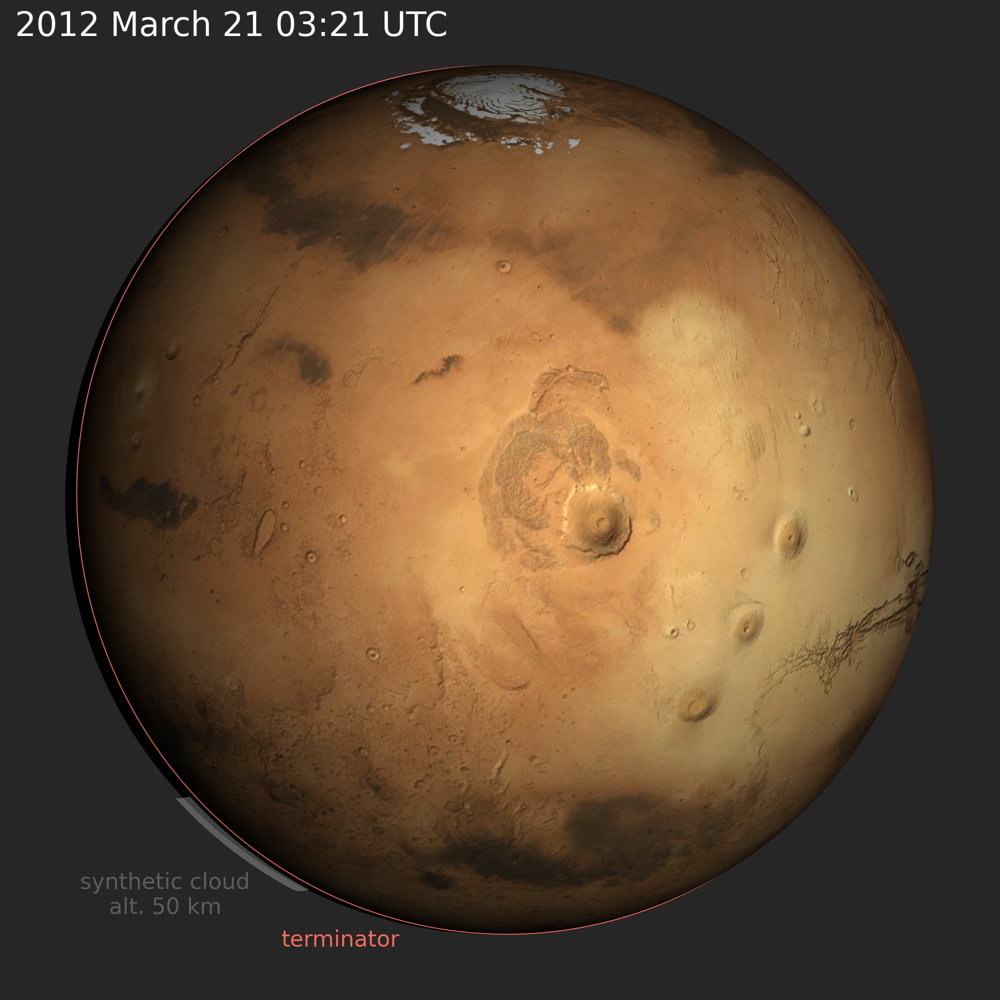

In [17]:
utc='2012 March 21 03:21 UTC'
rgb_arr = earth_mars_view(utc, draw_cloud=True, draw_sza_contours=False, draw_terminator=True, draw_sza_100=False, draw_latlon=False, background_color=(0.15,0.15,0.15));
mars_img = Image.fromarray(rgb_arr)

/tmp/ipykernel_95885/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


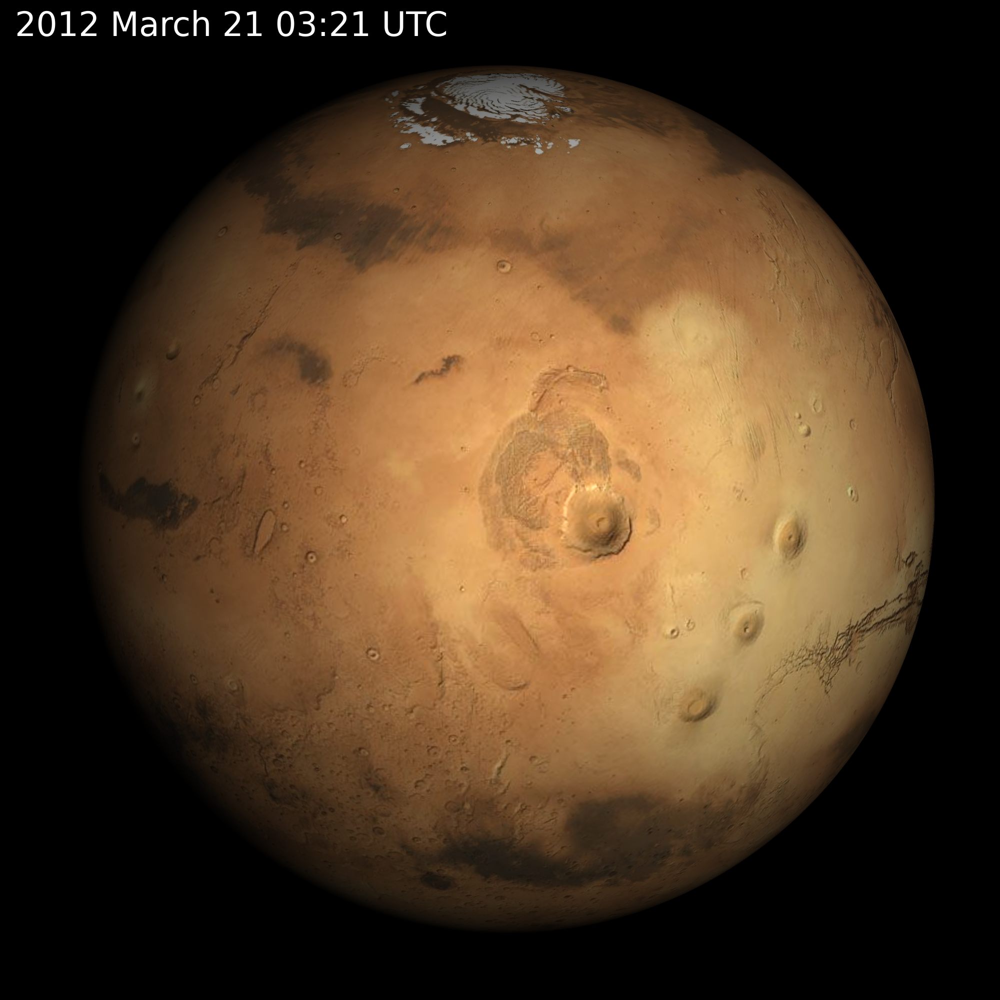

In [18]:
utc='2012 March 21 03:21 UTC'
rgb_arr = earth_mars_view(utc, draw_cloud=False, draw_sza_contours=False, draw_terminator=False, draw_sza_100=False, draw_latlon=False);

cloud_radius = 1.0147275405007363
cloud_end_sza = 99.77360299799814


/tmp/ipykernel_95885/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


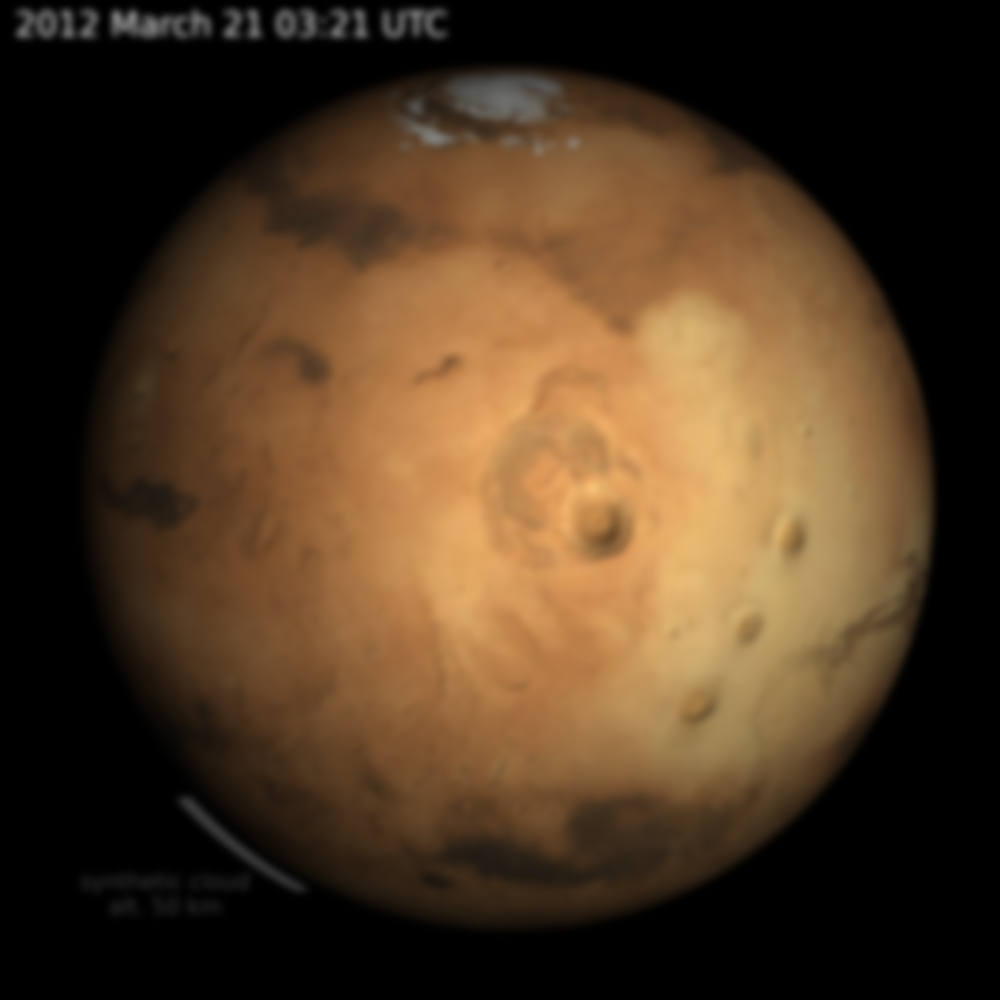

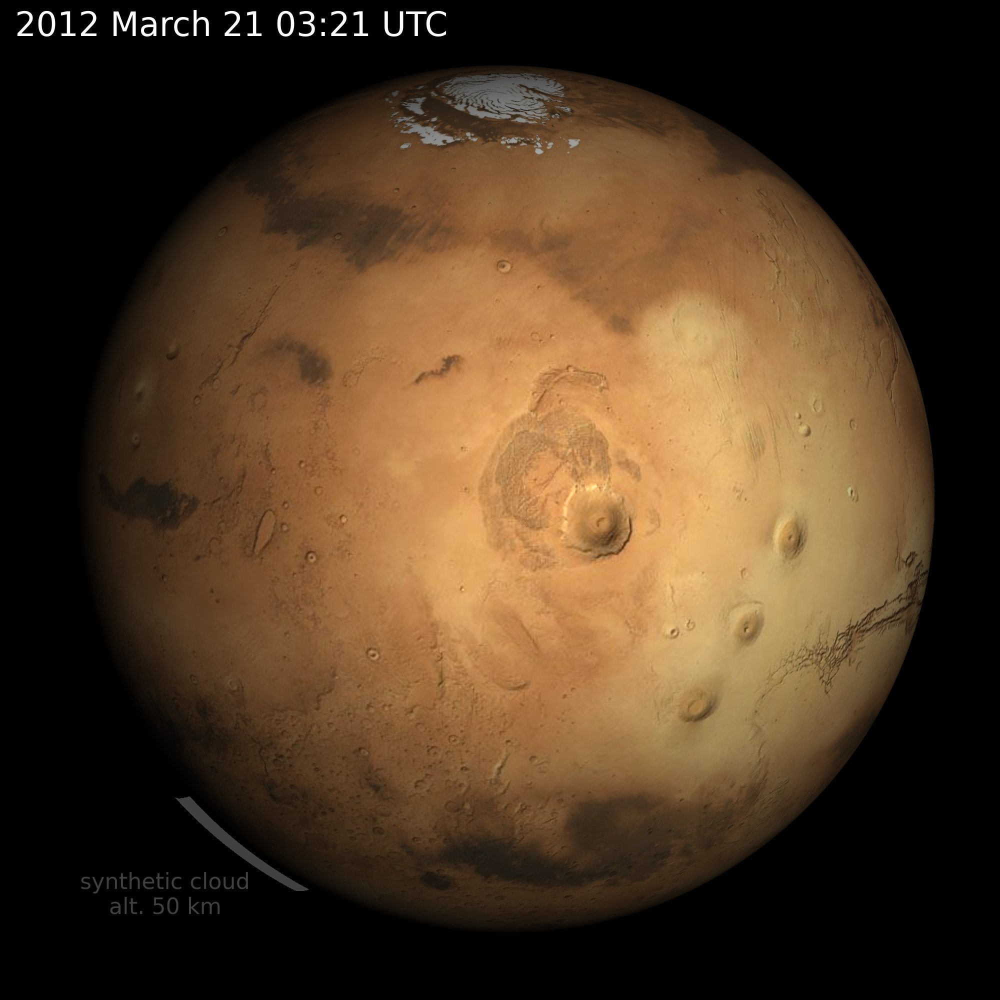

In [19]:
from PIL import ImageFilter
rgb_arr = earth_mars_view(utc, draw_cloud=True, draw_sza_contours=False, draw_terminator=False, draw_sza_100=False, draw_latlon=False);
mars_img = Image.fromarray(rgb_arr)
mars_img.filter(ImageFilter.GaussianBlur(radius=7.5)) # corresponds to ~1.5" seeing

/tmp/ipykernel_95885/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


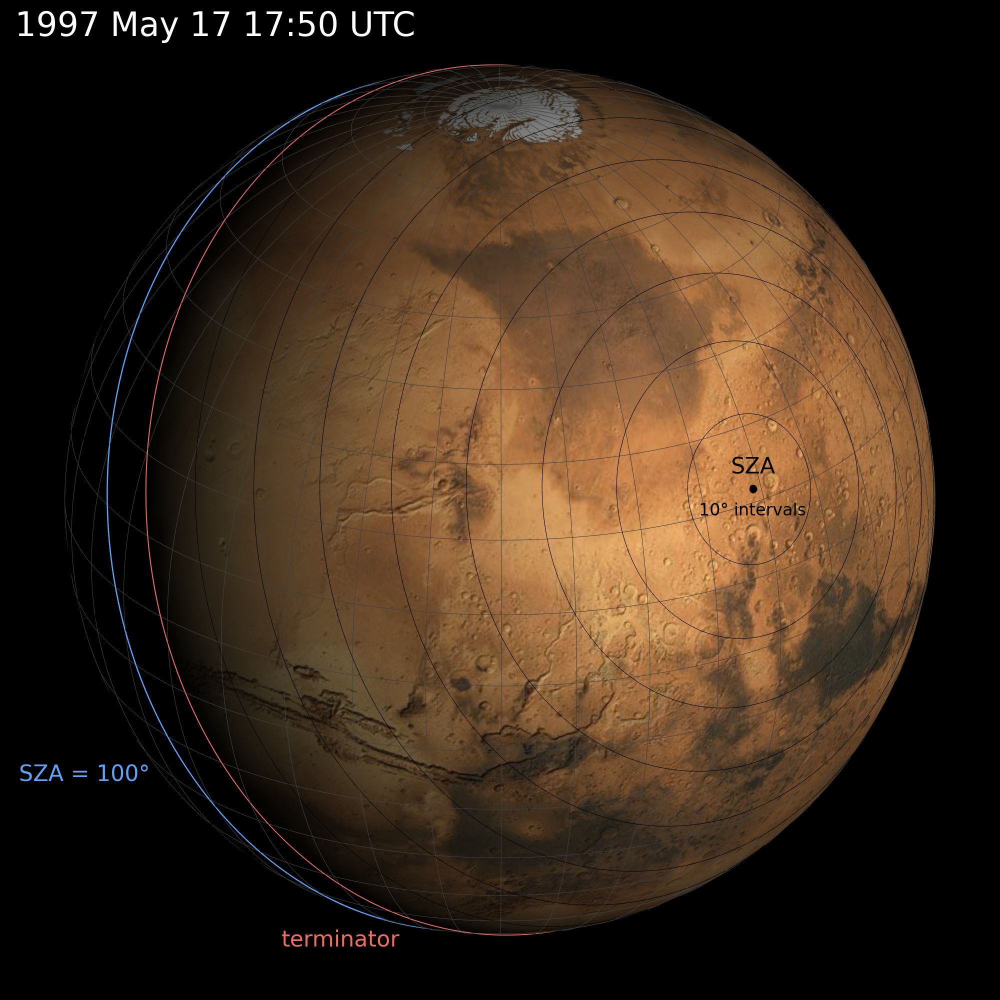

In [20]:
utc='1997 May 17 17:50 UTC'
rgb_arr = earth_mars_view(utc);
mars_img = Image.fromarray(rgb_arr)

/tmp/ipykernel_95885/975561188.py:3: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  buf = fig.canvas.tostring_rgb()


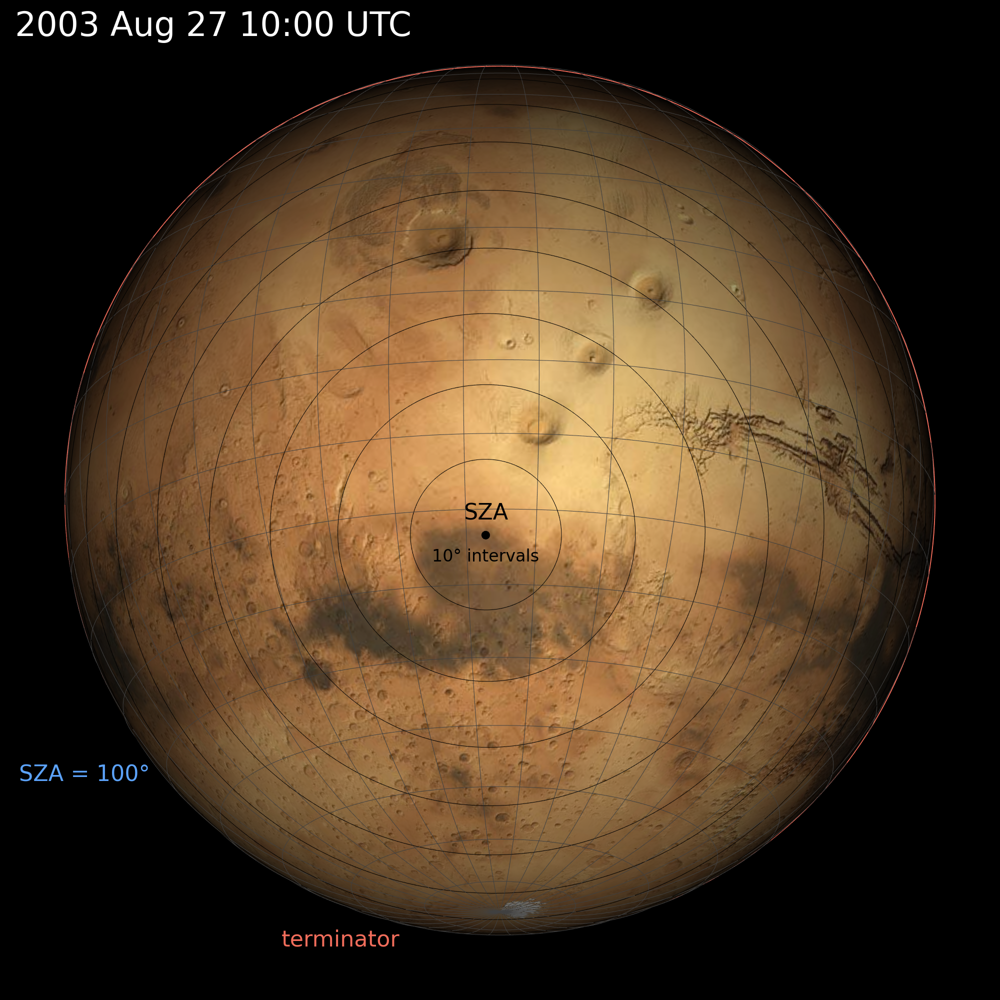

In [21]:
utc='2003 Aug 27 10:00 UTC'
rgb_arr = earth_mars_view(utc);
mars_img = Image.fromarray(rgb_arr)